In [1]:
import scanpy as sc
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

import seaborn as sns

import squidpy as sq

import celltypist
from celltypist import models

from matplotlib import rcParams

In [2]:
adata = sc.read_h5ad("h5ad/xenium5k_scVI.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [866]:
# scanpy plotting settings
sc.settings.figdir = "./figures_mesenchymal"
sc.set_figure_params(dpi_save=300)

In [916]:
import warnings

warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

# Mesenchymal cells subset

In [4]:
# Mesenchymal subset
adata_mesen = adata[adata.obs.megagut_lvl1_majority_voting == 'Mesenchymal']

In [6]:
adata_mesen

View of AnnData object with n_obs × n_vars = 218216 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

In [3]:
adata_mesen.obs.megagut_lvl3_majority_voting.value_counts()

NameError: name 'adata_mesen' is not defined

In [8]:
# Exclude cells that are not consistent with mesenchymal compartment according to level 3 CellTypist predictions
exclude_cells = ["Enterocyte", "Tnaive/cm_CD4", "B_memory", "Glial/Enteric_neural_crest", "Trm_CD8", "Treg_IL10", "EC_capillary", "EC_lymphatic", "Trm_CD4", "Mesoderm_2"]

adata_mesen = adata_mesen[~adata_mesen.obs.megagut_lvl3_majority_voting.isin(exclude_cells)]

In [9]:
adata_mesen

View of AnnData object with n_obs × n_vars = 181597 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

In [10]:
# Transfer annotations to full adata object
adata.obs.loc[adata.obs.index.isin(adata_mesen.obs.index), 'annot_level1'] = "Mesenchymal"

In [11]:
adata.obs.annot_level1.value_counts()

annot_level1
nan            464524
Mesenchymal    181597
Name: count, dtype: int64

In [158]:
# randomize cell order for plots
adata = sc.pp.subsample(adata, fraction=1, copy=True)

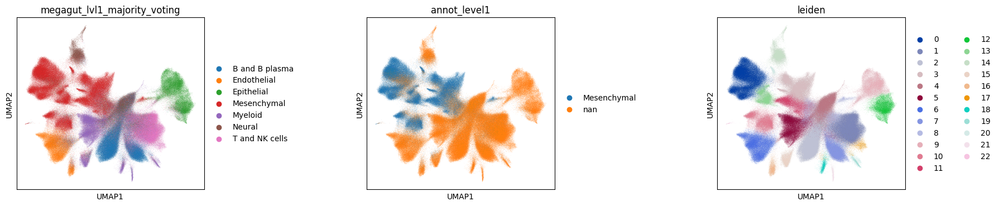

In [159]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata,
    color=[
        "megagut_lvl1_majority_voting", "annot_level1", "leiden"
    ],
    wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
)

In [147]:
adata.obs.annot_matthias[adata.obs.annot_matthias == 'unknown'] = pd.NA
adata.obs.annot_matthias = adata.obs.annot_matthias.cat.remove_categories('unknown')

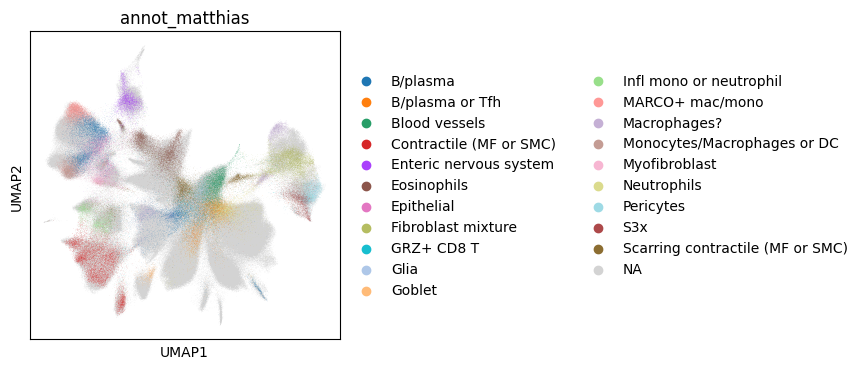

In [857]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata,
    color=[
        "annot_matthias"
    ],
    wspace=0.7,
#    legend_loc="on data",
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    palette=sc.pl.palettes.vega_20_scanpy
)

## Recompute UMAPs for subset

In [16]:
# # Recompute dimensionality reduction across samples
# sc.pp.pca(adata_mesen)
# sc.pp.neighbors(adata_mesen)

In [17]:
sc.pp.neighbors(adata_mesen, use_rep="X_scVI")

In [19]:
# UMAP
sc.tl.umap(adata_mesen)

## Leiden clustering

In [280]:
sc.tl.leiden(adata_mesen, resolution=1.0, key_added='leiden1')

In [278]:
sc.tl.leiden(adata_mesen, resolution=2.0, key_added='leiden2')

In [279]:
sc.tl.leiden(adata_mesen, resolution=4.0, key_added='leiden4')

In [95]:
#sc.tl.leiden(adata_mesen, resolution=10.0, key_added='leiden10')
sc.tl.leiden(adata_mesen, resolution=5.0, key_added='leiden5')

IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


In [156]:
# randomize order for plotting purposes
adata_mesen = sc.pp.subsample(adata_mesen, fraction=1, copy=True)

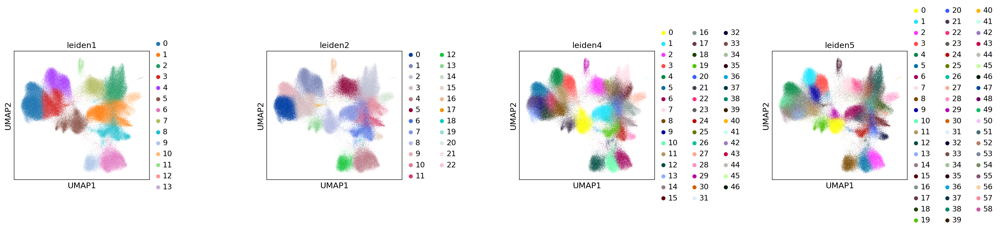

In [911]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_mesen,
    color=[
        "leiden1", "leiden2", "leiden4", "leiden5"
    ], 
    wspace=0.7,
    save="_xenium5k_mesenchymal_leiden_resolution_comparison.pdf"
)

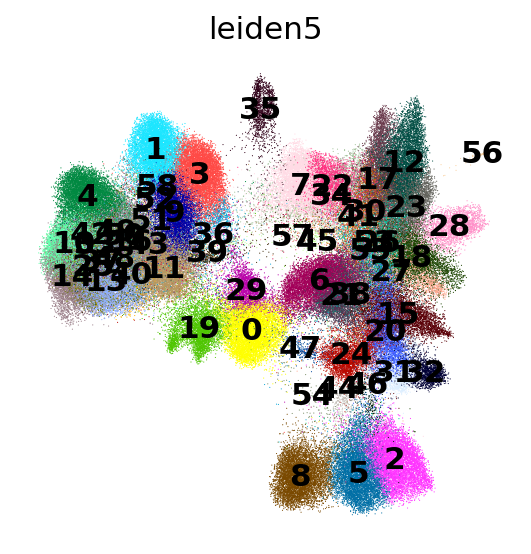

In [914]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(adata_mesen, color=['leiden5'],
           color_map="magma_r",
           frameon=False,
           size=1,
           legend_loc='on data'           
)

## Annotation

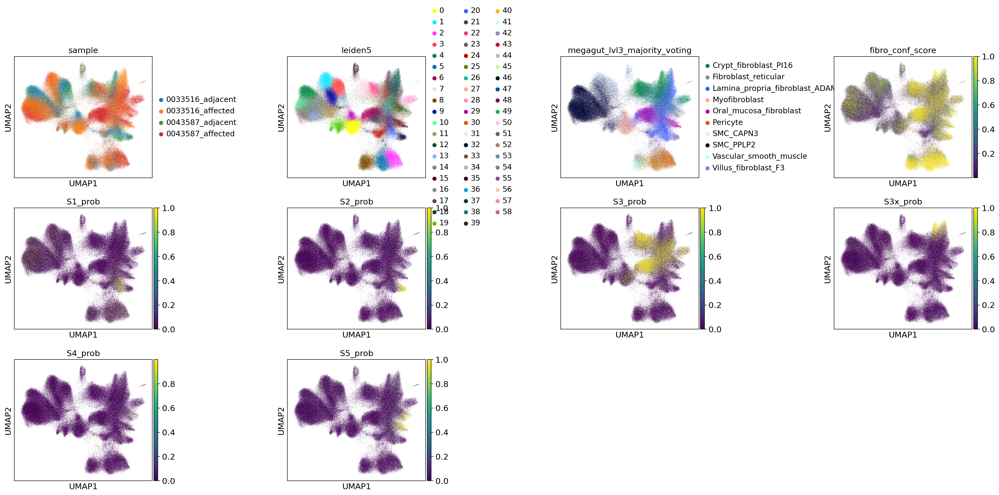

In [913]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_mesen,
    color=[
        "sample", "leiden5", "megagut_lvl3_majority_voting",
        "fibro_conf_score", "S1_prob", "S2_prob", "S3_prob", "S3x_prob", "S4_prob", "S5_prob"
    ], 
    wspace=0.8,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5_mesenchymal_CellTypist_comparison.pdf"
)

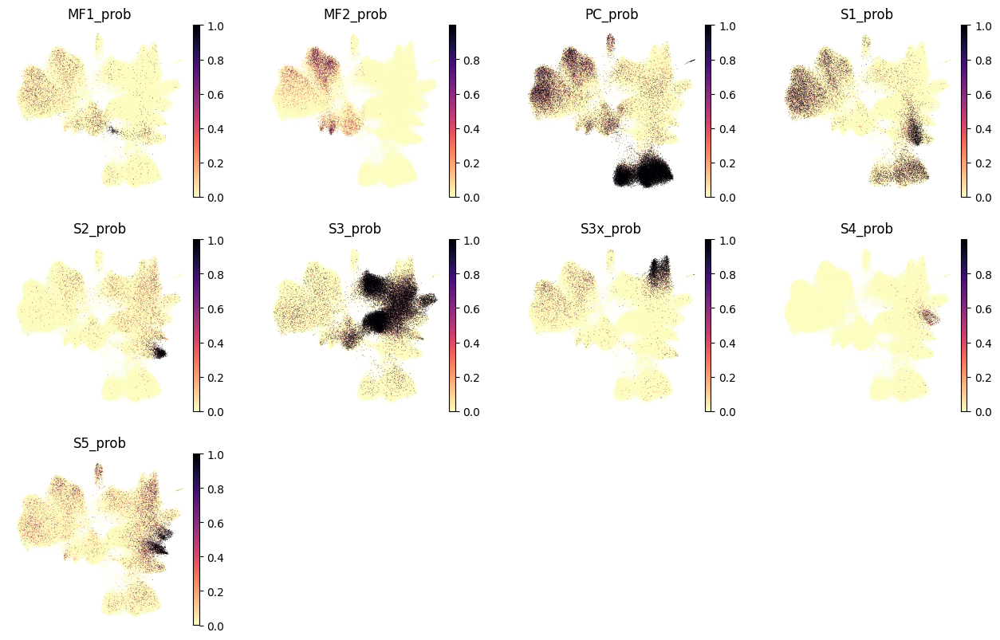

In [162]:
# Plots of all posterior probabilityes per fibroblast sybtype
rcParams["figure.figsize"] = (3, 3)

subtypes = ['MF1', 'MF2', 'PC', 'S1', 'S2', 'S3', 'S3x', 'S4', 'S5']

sc.pl.umap(adata_mesen, color=[x + "_prob" for x in subtypes], color_map="magma_r", frameon=False, size=1,
           #save="_megagut_fibro_celltypist_probs"
)

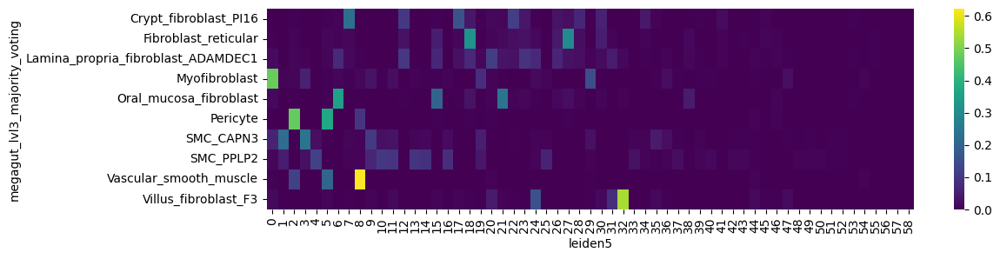

In [114]:
conf_mat = sc.metrics.confusion_matrix("megagut_lvl3_majority_voting", "leiden5", adata_mesen.obs)
rcParams['figure.figsize'] = 12, 3.0
sns.heatmap(
    conf_mat,
    xticklabels=True,
    yticklabels=True,
    cmap='viridis'
)

plt.show()

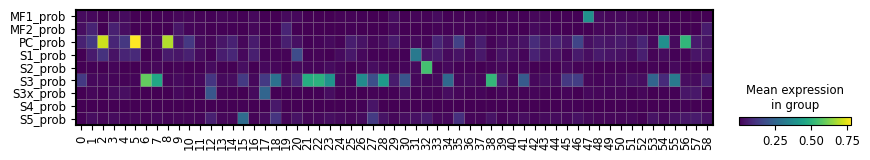

In [341]:
# Average CellTypist probability by cluster
subtypes = ['MF1', 'MF2', 'PC', 'S1', 'S2', 'S3', 'S3x', 'S4', 'S5']

sc.pl.matrixplot(
    adata_mesen, [x + "_prob" for x in subtypes], groupby='leiden5', figsize=(10, 1.5), swap_axes=True)

In [915]:
#adata_mesen

In [797]:
# Default to CellTypist prediction
#adata_mesen.obs['annot'] = adata_mesen.obs.megagut_lvl3_majority_voting.astype(str)

# Default to NA
adata_mesen.obs['annot'] = pd.NA

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '0', 'annot'] = "Myofibroblast_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '29', 'annot'] = "Myofibroblast_2"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '47', 'annot'] = "Myofibroblast_3"

# SMC
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '1', 'annot'] = "SMC_CAPN3_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '3', 'annot'] = "SMC_CAPN3_2"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '9', 'annot'] = "SMC_CAPN3_3"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '36', 'annot'] = "SMC_CAPN3_4"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '35', 'annot'] = "SMC_ANO1"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '4', 'annot'] = "SMC_PPLP2_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '10', 'annot'] = "SMC_PPLP2_2"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '11', 'annot'] = "SMC_PPLP2_3"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '13', 'annot'] = "SMC_PPLP2_4"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '14', 'annot'] = "SMC_PPLP2_5"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '16', 'annot'] = "SMC_PPLP2_6"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '25', 'annot'] = "SMC_PPLP2_7"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '33', 'annot'] = "SMC_PPLP2_8"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '19', 'annot'] = "Myofibroblast-SMC"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '8', 'annot'] = "vSMC"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '2', 'annot'] = "Pericyte_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '5', 'annot'] = "Pericyte_2"

# Cluster with low confidence for fibroblast subtype CellTypist
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '24', 'annot'] = "Villus fibroblast_F3"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '31', 'annot'] = "S1_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '20', 'annot'] = "S1_2"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '32', 'annot'] = "S2"

# S3
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '6', 'annot'] = "S3_oral_mucosa-like_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '21', 'annot'] = "S3_oral_mucosa-like_2"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '38', 'annot'] = "S3_oral_mucosa-like_3"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '7', 'annot'] = "S3_crypt_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '22', 'annot'] = "S3_crypt_2"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '30', 'annot'] = "S3_crypt_3"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '34', 'annot'] = "S3_crypt_4"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '28', 'annot'] = "S3_EGR3"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '45', 'annot'] = "S3_GATA2"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '23', 'annot'] = "S3_lamina propria_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '26', 'annot'] = "S3_lamina propria_2"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '55', 'annot'] = "S3_lamina propria_3"
#adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '53', 'annot'] = "S3_SF3B1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '53', 'annot'] = "S3_lamina propria_4"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '41', 'annot'] = "S3_intermediate"  # in-between S3 and S3x

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '15', 'annot'] = "S5"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '18', 'annot'] = "S4"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '27', 'annot'] = "S4"

adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '12', 'annot'] = "S3x_1"
adata_mesen.obs.loc[adata_mesen.obs.leiden5 == '17', 'annot'] = "S3x_2"

exclude_clust = ['46', '48', '49', '50', '51', '52', '54', '56', '57', '58']
adata_mesen.obs.loc[adata_mesen.obs.leiden5.isin(exclude_clust), 'annot'] = pd.NA  # low quality


In [798]:
# S5
#adata_mesen.obs.loc[adata_mesen.obs.S5_prob > 0.5, 'annot'] = "S5"
#adata_mesen.obs.loc[(adata_mesen.obs.megagut_lvl3_majority_voting == "Oral_mucosa_fibroblast") & (adata_mesen.obs.leiden == '16'), 'annot'] = "S5"
#adata_mesen.obs.loc[adata_mesen.obs.subtype_annot == 'S5', 'annot'] = "S5"
#adata_mesen.obs.loc[adata_mesen.obs.subtype_annot == 'S3x', 'annot'] = "S3x"

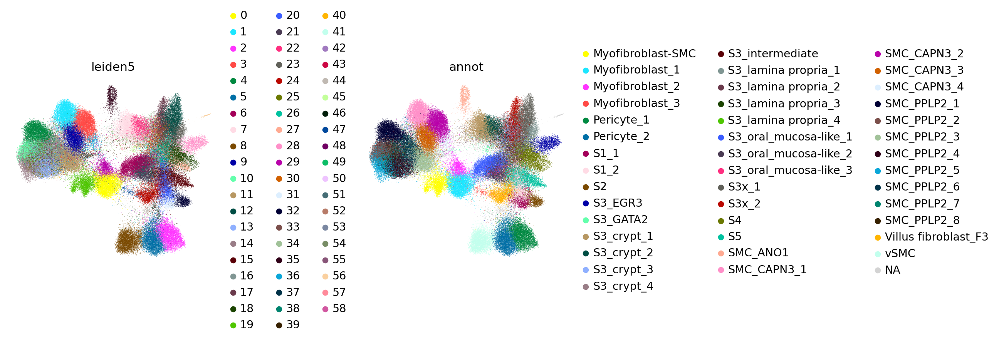

In [867]:
# UMAP of annotation
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(adata_mesen, color=['leiden5', 'annot'],
           color_map="magma_r",
           wspace=0.5,
           frameon=False,
           size=1,
           save="_xenium5k_mesenchymal_annot1"
)

In [800]:
# conf_mat = sc.metrics.confusion_matrix("subtype_annot", "leiden", adata_mesen.obs)
# rcParams['figure.figsize'] = 9, 3.0
# sns.heatmap(
#     conf_mat,
#     xticklabels=True,
#     yticklabels=True,
#     cmap='viridis'
# )

# plt.show()

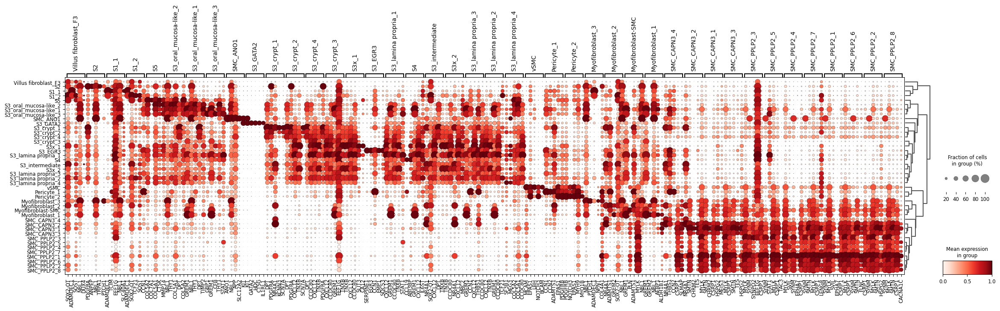

In [803]:
# Investigate markers
sc.tl.dendrogram(adata_mesen, groupby='annot')

sc.tl.rank_genes_groups(adata_mesen, groupby='annot', method='wilcoxon')

sc.pl.rank_genes_groups_dotplot(
    adata_mesen, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(28, 6)
)

## Merge clusters based on similarity (annot2)

In [804]:
adata_mesen.obs['annot2'] = adata_mesen.obs.annot

adata_mesen.obs.annot2 = adata_mesen.obs.annot2.cat.add_categories(['S3_oral_mucosa-like', 'S3_crypt', 'S3_lamina propria', 'SMC_CAPN3', 'SMC_PPLP2'])

# Collapse SMC
#adata_mesen.obs.annot2[adata_mesen.obs.annot2.str.contains("^SMC", na=False)] = "SMC"
adata_mesen.obs.annot2[adata_mesen.obs.annot2.str.contains("^SMC_CAPN3", na=False)] = "SMC_CAPN3"
adata_mesen.obs.annot2[adata_mesen.obs.annot2.str.contains("^SMC_PPLP2", na=False)] = "SMC_PPLP2"

adata_mesen.obs.annot2[adata_mesen.obs.annot2.str.contains("^S3_oral", na=False)] = "S3_oral_mucosa-like"
adata_mesen.obs.annot2[adata_mesen.obs.annot2.str.contains("^S3_crypt", na=False)] = "S3_crypt"
adata_mesen.obs.annot2[adata_mesen.obs.annot2.str.contains("^S3_lamina propria", na=False)] = "S3_lamina propria"

#adata_mesen.obs.annot2 = adata_mesen.obs.annot2.astype(str)
adata_mesen.obs.annot2 = adata_mesen.obs.annot2.cat.remove_unused_categories()

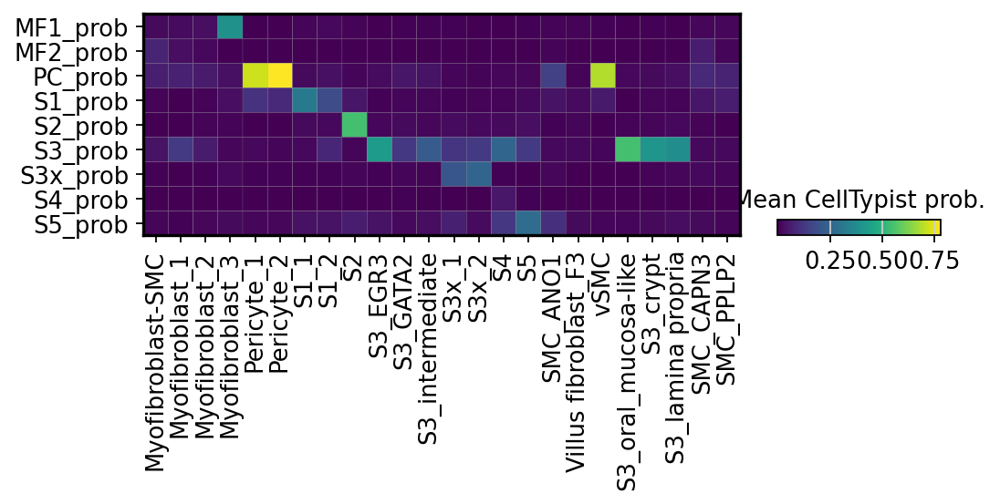

In [907]:
# Map consolidated clusters to CellTypist average probabilities
subtypes = ['MF1', 'MF2', 'PC', 'S1', 'S2', 'S3', 'S3x', 'S4', 'S5']

sc.pl.matrixplot(
    adata_mesen, [x + "_prob" for x in subtypes], groupby='annot2', figsize=(7, 2.0), swap_axes=True,
    colorbar_title="Mean CellTypist prob.",
    save="CellTypist_annot2.pdf")

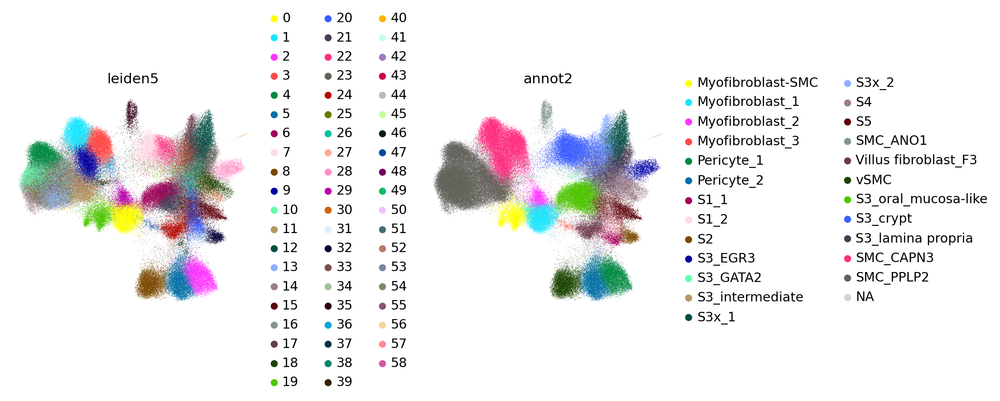

In [871]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_mesen,
    color=['leiden5','annot2'],
    color_map="magma_r",
    wspace=0.5,
    frameon=False,
    size=1,
    palette=sc.pl.palettes.default_102,
    save="_xenium5k_mesenchymal_annot2.pdf"
)

In [872]:
# rcParams["figure.figsize"] = (8, 8)

# sc.pl.umap(adata_mesen, color=['annot2'],
#            color_map="magma_r",
# #           wspace=0.5,
#            frameon=False,
#            size=1,
#            legend_loc='on data'
# #           save="_xenium5k_mesenchymal",
           
# )

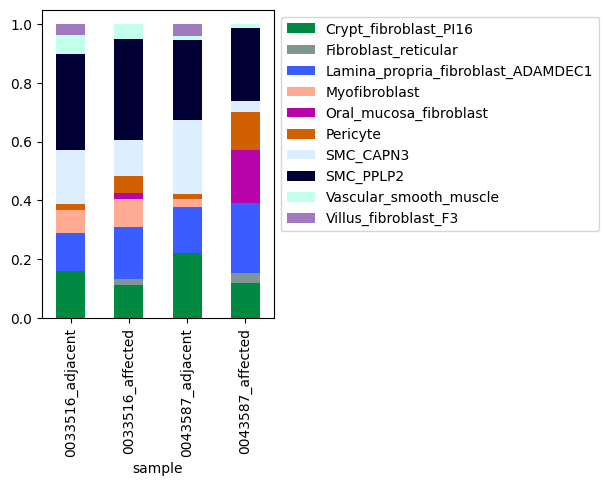

In [863]:
# Get dictionary of colors
color_dict = dict(zip(adata.obs.megagut_lvl3_majority_voting.cat.categories, adata.uns['megagut_lvl3_majority_voting_colors']))

rcParams["figure.figsize"] = (3, 4)

counts = pd.crosstab(adata_mesen.obs.megagut_lvl3_majority_voting, adata_mesen.obs['sample'], normalize='columns')
ax = counts.T.plot(kind='bar', stacked=True, color=counts.index.map(color_dict))
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.grid(False)

plt.savefig("figures_mesenchymal/barplot_xenium5k_celltypist_level3_mesenchymal.pdf", bbox_inches ="tight")
#plt.show()

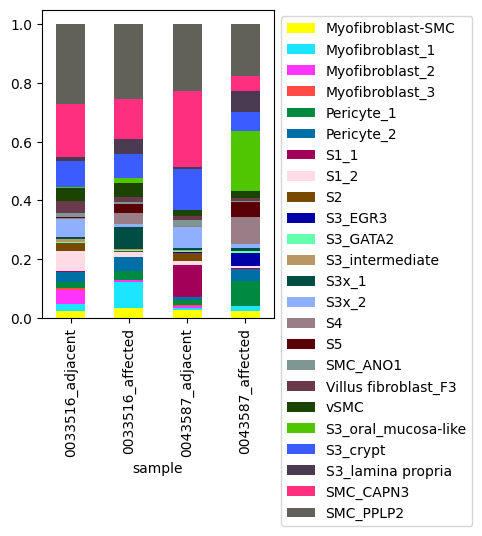

In [864]:
rcParams["figure.figsize"] = (3, 4)

# Get dictionary of colors
color_dict = dict(zip(adata_mesen.obs.annot2.cat.categories, adata_mesen.uns['annot2_colors']))

counts = pd.crosstab(adata_mesen.obs.annot2, adata_mesen.obs['sample'], normalize='columns')
ax = counts.T.plot(kind='bar', stacked=True, color=counts.index.map(color_dict))
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.grid(False)

plt.savefig("figures_mesenchymal/barplot_xenium5k_annotation_mesenchymal.pdf", bbox_inches ="tight")

In [2]:
#adata_mesen

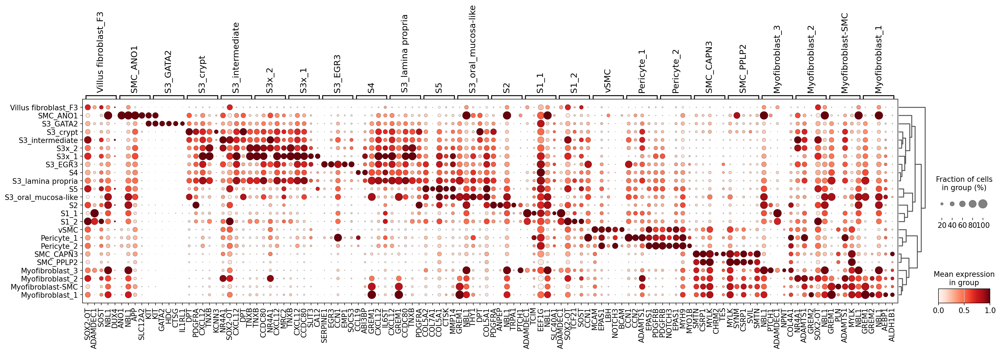

In [901]:
# Dotplot of markers
sc.tl.dendrogram(adata_mesen, groupby='annot2')

sc.tl.rank_genes_groups(adata_mesen, groupby='annot2', method='wilcoxon')

sc.pl.rank_genes_groups_dotplot(
    adata_mesen, groupby='annot2', standard_scale="var", n_genes=5, title="", figsize=(26, 6),
    save="xenium5k_mesenchymal_annot2.pdf"
)

In [971]:
# write annotated object to file
adata_mesen.write_h5ad("h5ad/scvi/xenium5k_scVI_annotated_mesenchymal.h5ad")

## Smooth muscle cell subclusters

In [812]:
adata_smc = adata_mesen[np.where(adata_mesen.obs.annot.str.contains("^SMC"))]

adata_smc = adata_smc[~(adata_smc.obs.annot == "vSMC")]
adata_smc

View of AnnData object with n_obs × n_vars = 72312 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [813]:
adata_smc.obs.annot.value_counts()

annot
SMC_CAPN3_1    7557
SMC_CAPN3_2    7446
SMC_PPLP2_1    7044
SMC_CAPN3_3    6224
SMC_PPLP2_2    6217
SMC_PPLP2_3    6105
SMC_PPLP2_4    5662
SMC_PPLP2_5    5183
SMC_PPLP2_6    4922
SMC_PPLP2_7    3489
SMC_PPLP2_8    1679
SMC_ANO1       1435
SMC_CAPN3_4    1301
Name: count, dtype: int64

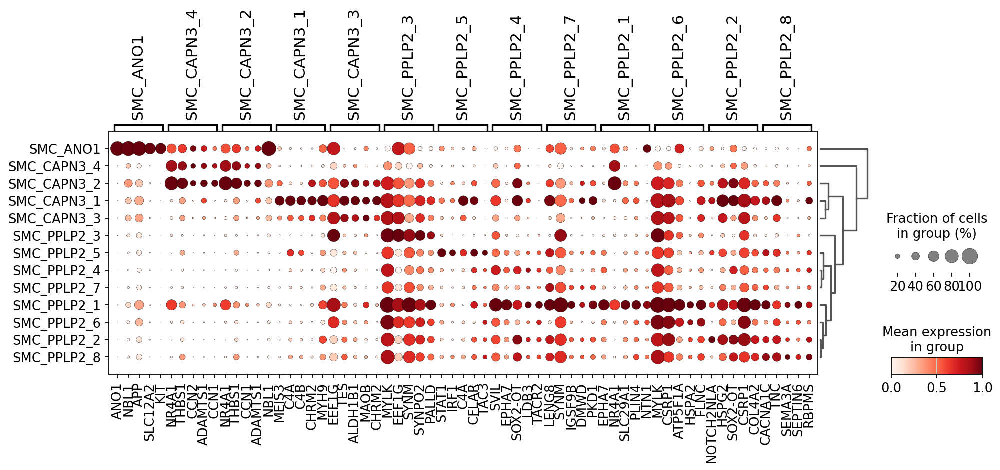

In [902]:
# Investigate markers
sc.tl.dendrogram(adata_smc, groupby='annot')

sc.tl.rank_genes_groups(adata_smc, groupby='annot', method='wilcoxon')

sc.pl.rank_genes_groups_dotplot(
    adata_smc, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(14, 4),
    save="xenium5k_mesenchymal_annot_SMC.pdf"
)

## S3 subclusters

In [816]:
adata_s3 = adata_mesen[np.where(adata_mesen.obs.annot.str.contains("S3"))]

adata_s3

View of AnnData object with n_obs × n_vars = 57275 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [817]:
adata_s3.obs.annot.value_counts()

annot
S3_oral_mucosa-like_1    6780
S3_crypt_1               6573
S3x_1                    5907
S3x_2                    4890
S3_oral_mucosa-like_2    4329
S3_crypt_2               4079
S3_lamina propria_1      4049
S3_lamina propria_2      3292
S3_EGR3                  2583
S3_crypt_3               2390
S3_crypt_4               1594
S3_oral_mucosa-like_3     981
S3_intermediate           772
S3_GATA2                  548
S3_lamina propria_4       255
S3_lamina propria_3       205
Name: count, dtype: int64

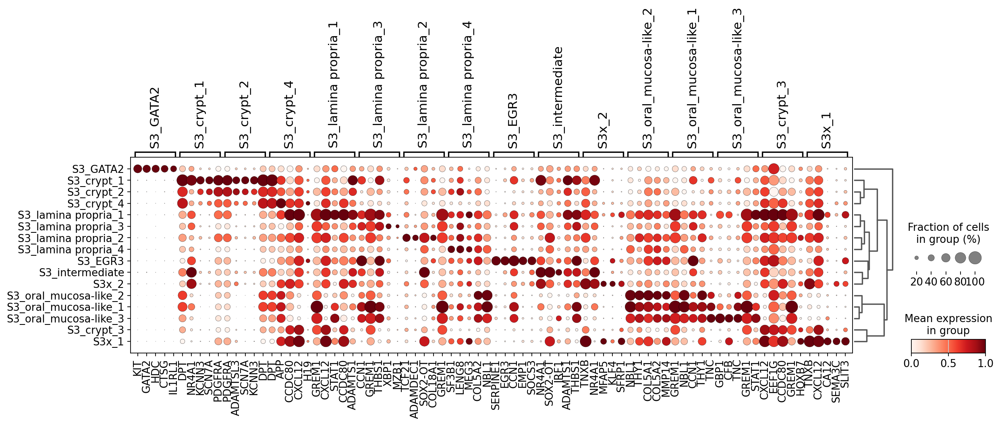

In [897]:
# Investigate markers
sc.tl.dendrogram(adata_s3, groupby='annot')

sc.tl.rank_genes_groups(adata_s3, groupby='annot', method='wilcoxon')

sc.pl.rank_genes_groups_dotplot(
    adata_s3, groupby='annot',
    standard_scale="var",
    n_genes=5, title="", figsize=(17, 4),
    save="xenium5k_mesenchymal_annot_S3.pdf"
)

## UMAPs of selected markers

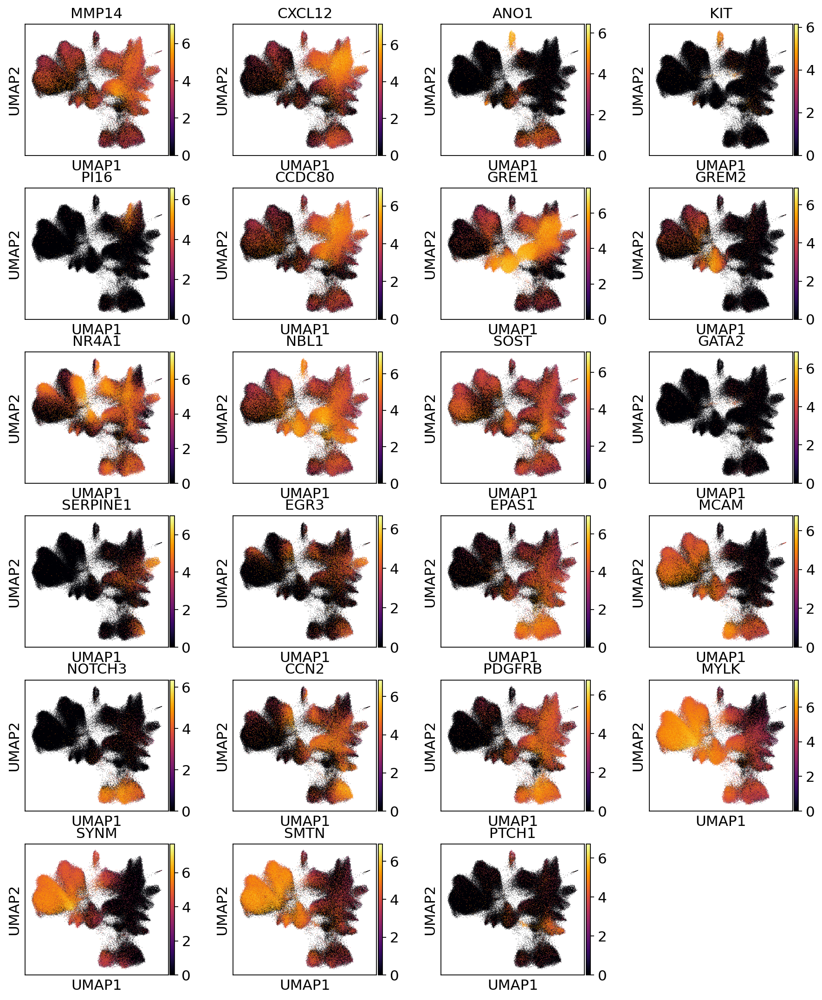

In [926]:
rcParams["figure.figsize"] = (2.5, 2.5)

sc.pl.umap(
    adata_mesen,
    color=[
        "MMP14", "CXCL12", "ANO1", "KIT",
        "PI16", "CCDC80",
        # myofibroblast    
        "GREM1", "GREM2", "NR4A1", "NBL1",    
        "SOST", "GATA2",
        "SERPINE1", "EGR3",
        "EPAS1", "MCAM", "NOTCH3",
        "CCN2", "PDGFRB",
        "MYLK", "SYNM", "SMTN",
        "PTCH1",
    ], 
#    wspace=0.7,
    cmap='inferno',
    save="_xenium5k_general_markers_mesenchymal.pdf"
)

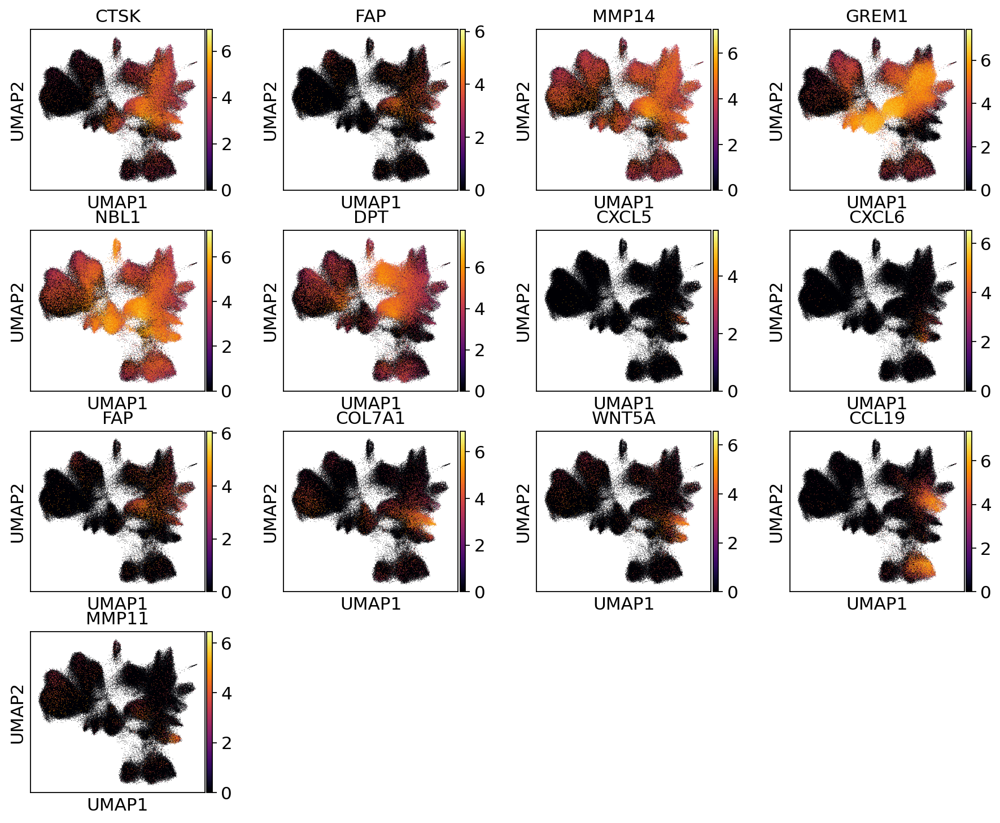

In [927]:
#rcParams["figure.figsize"] = (4, 4)

# S5/S4 markers
sc.pl.umap(
    adata_mesen,
    color=[
        # oral mucosa
        "CTSK", "FAP", "MMP14", "GREM1", "NBL1", "DPT",
        # S5
        "CXCL5", "CXCL6", "FAP", "COL7A1", "WNT5A",
        # S4
        "CCL19", "MMP11"
    ], 
#    wspace=0.7,
    cmap='inferno',
    save="_xenium5k_S4-S5_markers_mesenchymal.pdf"
)

# Spatial plots

In [821]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [822]:
#adata.obs.fibro_majority_voting.value_counts()

In [957]:
rcParams['figure.figsize'] = 7, 7
rcParams["axes.grid"] = False

# sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
#              x='x_centroid', y='y_centroid', color="S5_prob", size=3)

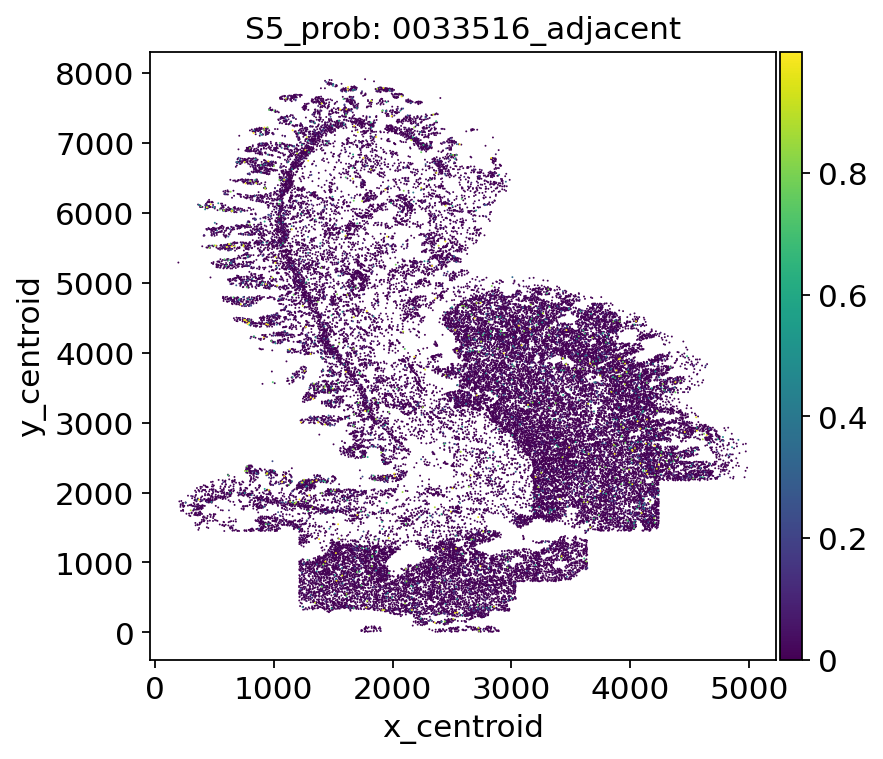

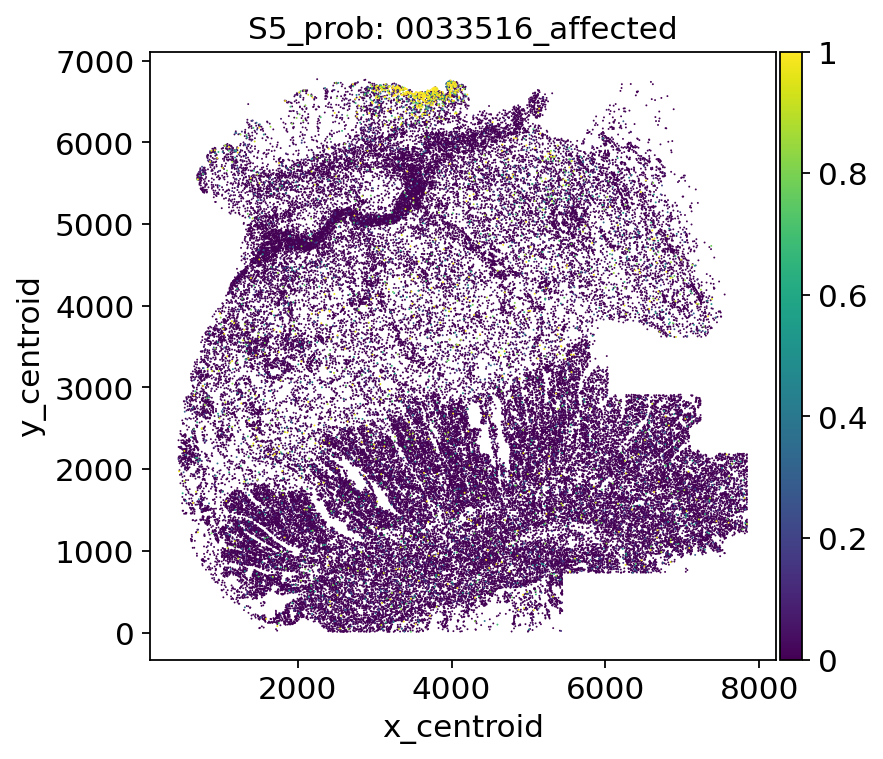

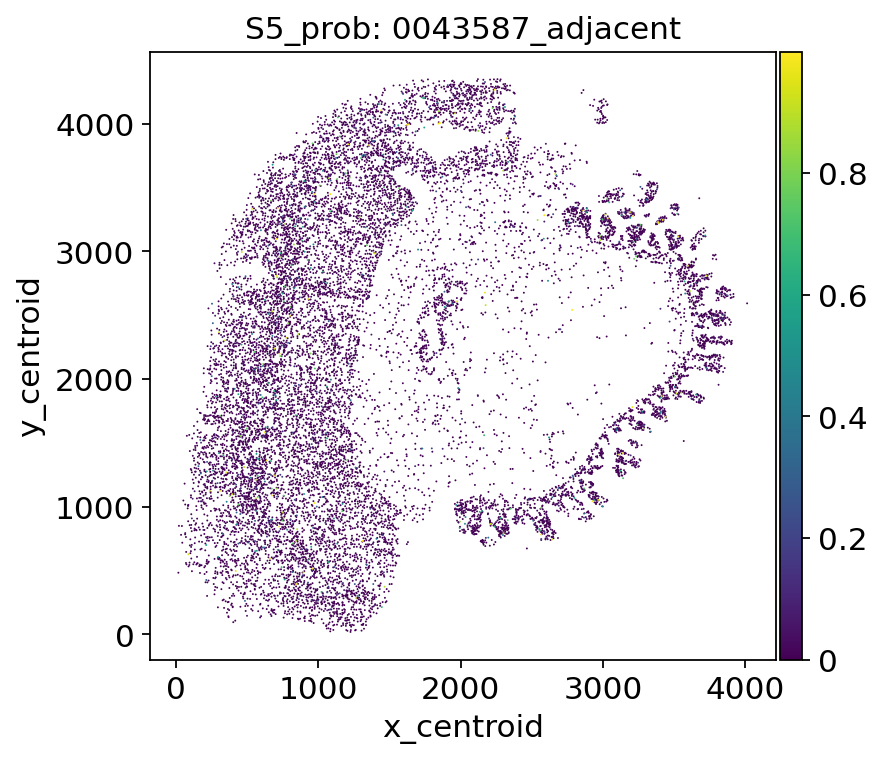

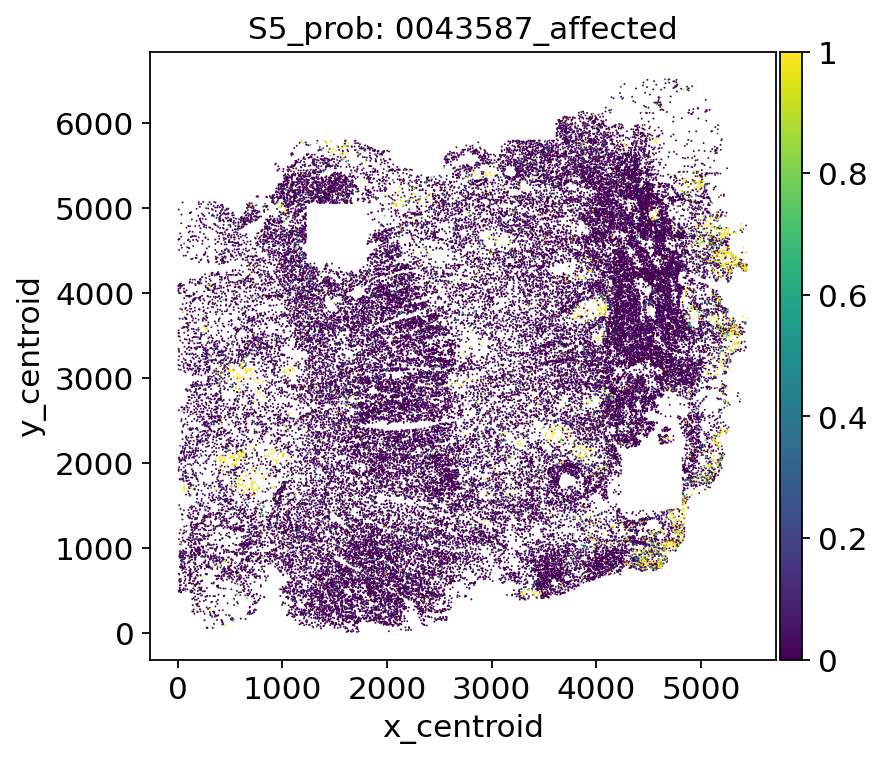

In [960]:
rcParams['figure.figsize'] = 5, 5

for sample in adata_mesen.obs['sample'].cat.categories:
    sc.pl.scatter(
        adata_mesen[adata_mesen.obs['sample'] == sample],
        x='x_centroid',
        y='y_centroid',
        color="S5_prob",
        size=3,
        title="S5_prob: " + sample,
        save="_mesenchymal_S5prob_" + sample + ".pdf"
    )

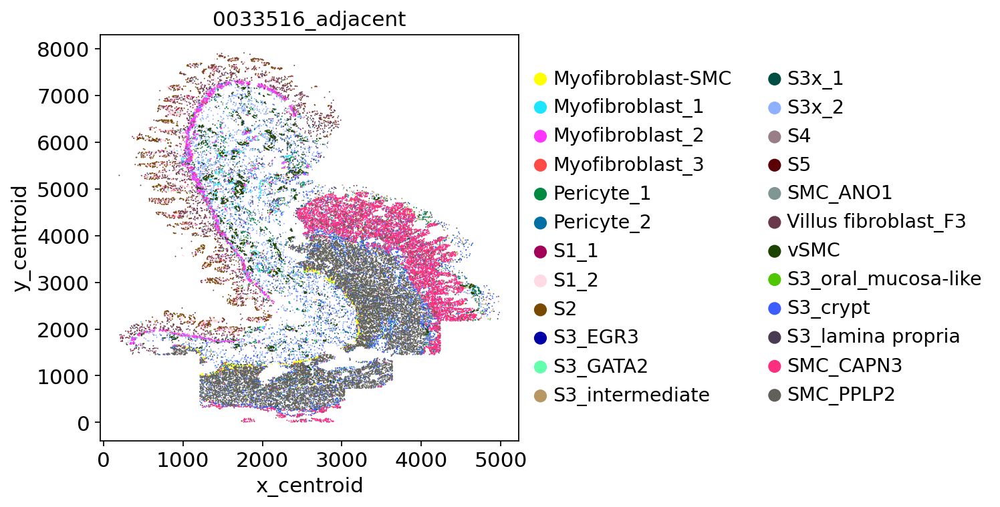

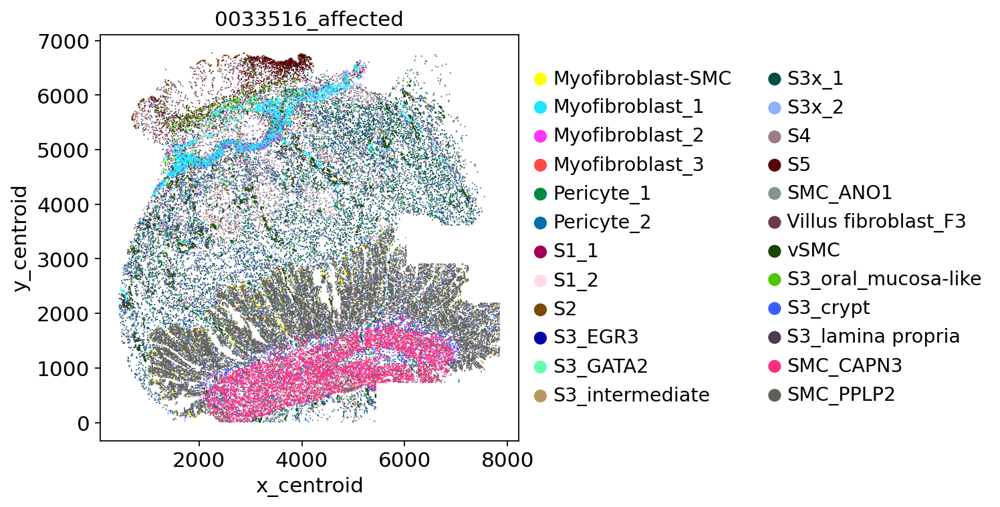

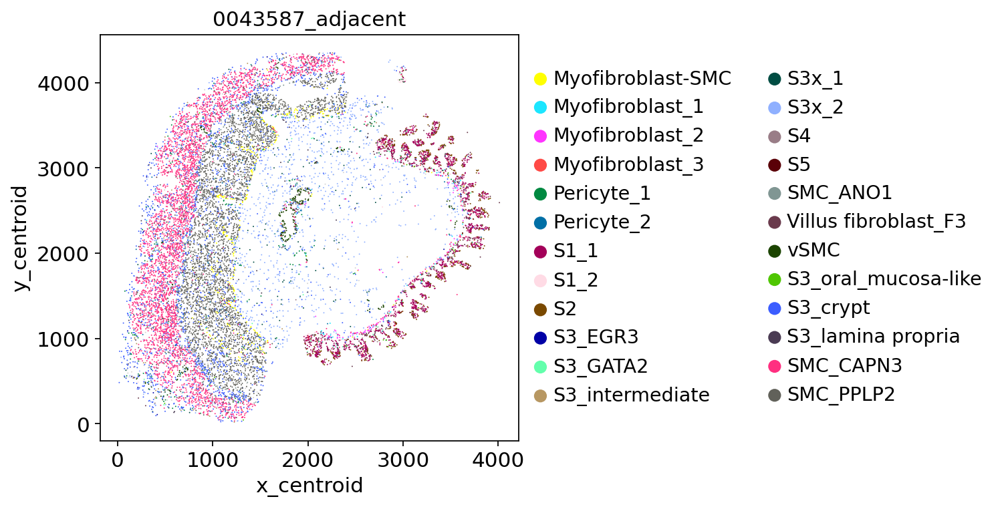

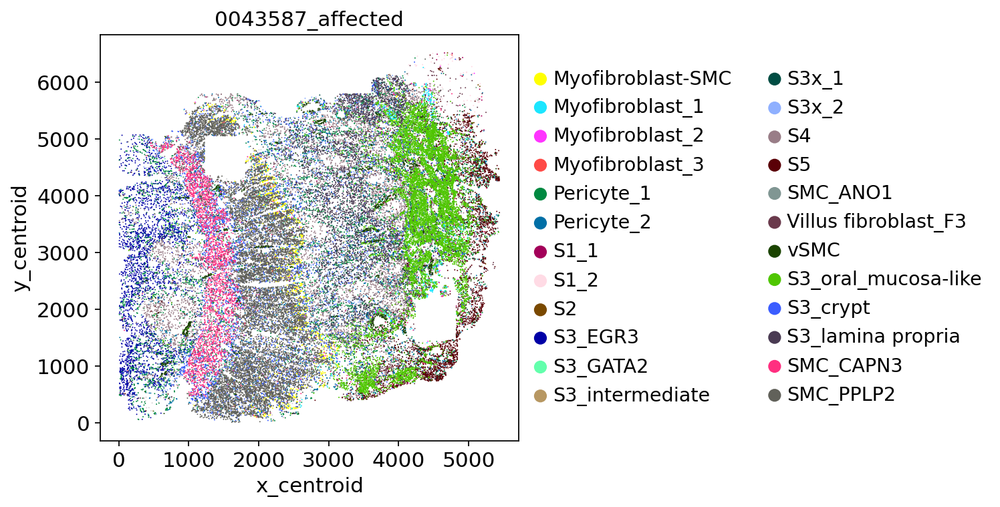

In [962]:
rcParams['figure.figsize'] = 5, 5

for sample in adata_mesen.obs['sample'].cat.categories:
    sc.pl.scatter(
        adata_mesen[adata_mesen.obs['sample'] == sample],
        x='x_centroid',
        y='y_centroid',
        color="annot2",
        size=3,
        title=sample,
        save="_mesenchymal_annot2_" + sample + ".pdf"
    )

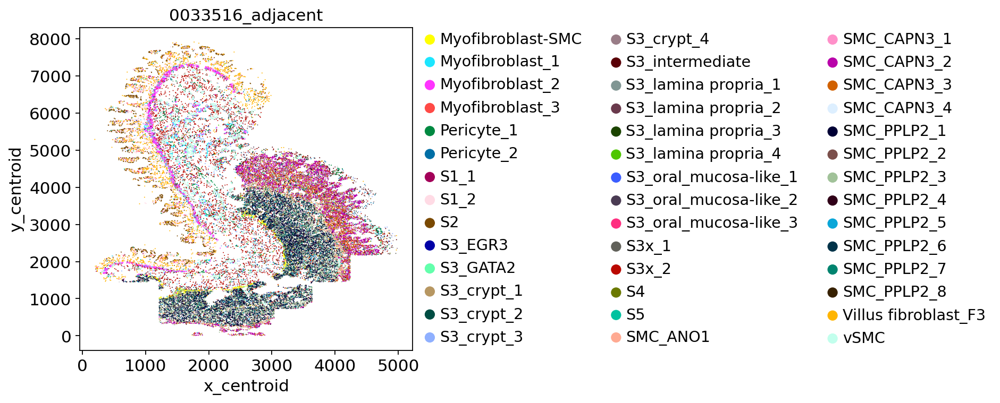

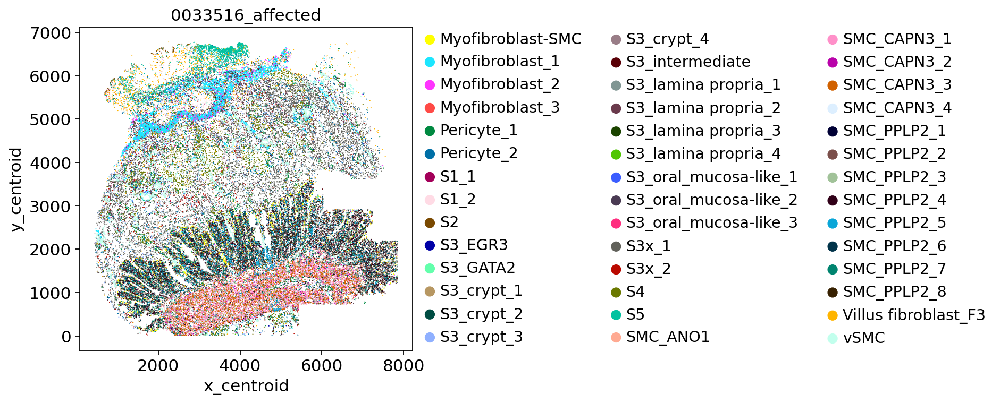

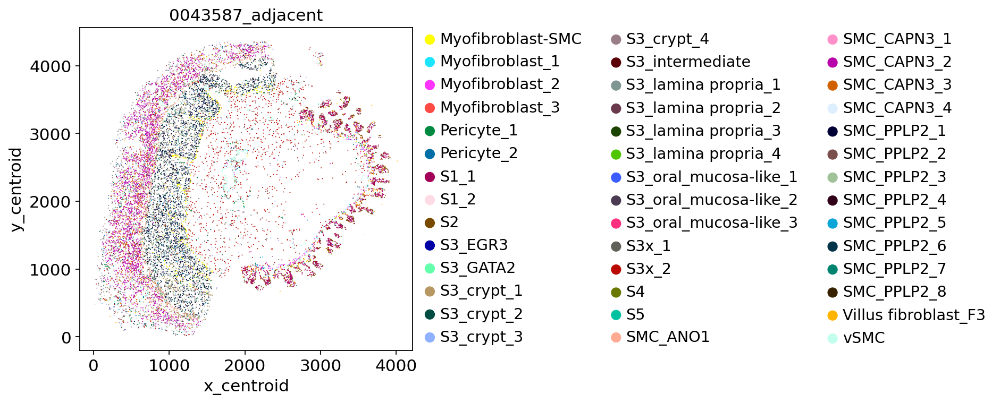

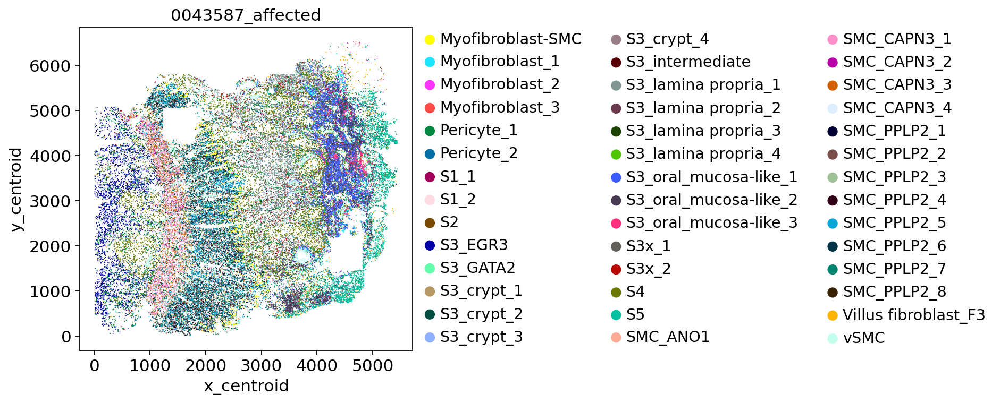

In [963]:
rcParams['figure.figsize'] = 5, 5

for sample in adata_mesen.obs['sample'].cat.categories:
    sc.pl.scatter(
        adata_mesen[adata_mesen.obs['sample'] == sample],
        x='x_centroid',
        y='y_centroid',
        color="annot",
        size=3,
        title=sample,
        save="_mesenchymal_annot_" + sample + ".pdf"
    )

In [946]:
# rcParams['figure.figsize'] = 6, 6.0
# sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
#              x='x_centroid', y='y_centroid', color="S4_prob")

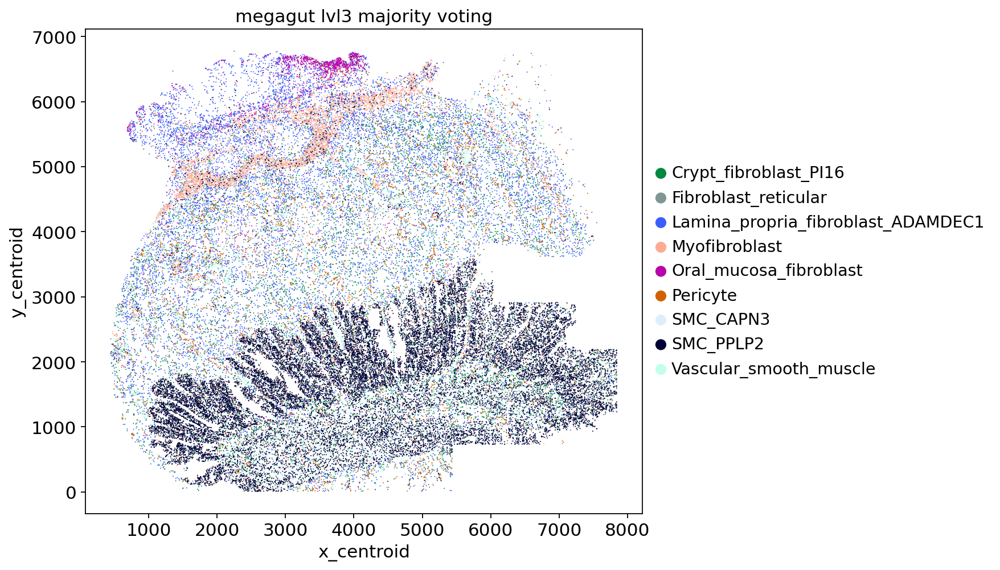

In [947]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
             x='x_centroid', y='y_centroid', color="megagut_lvl3_majority_voting", size=3)

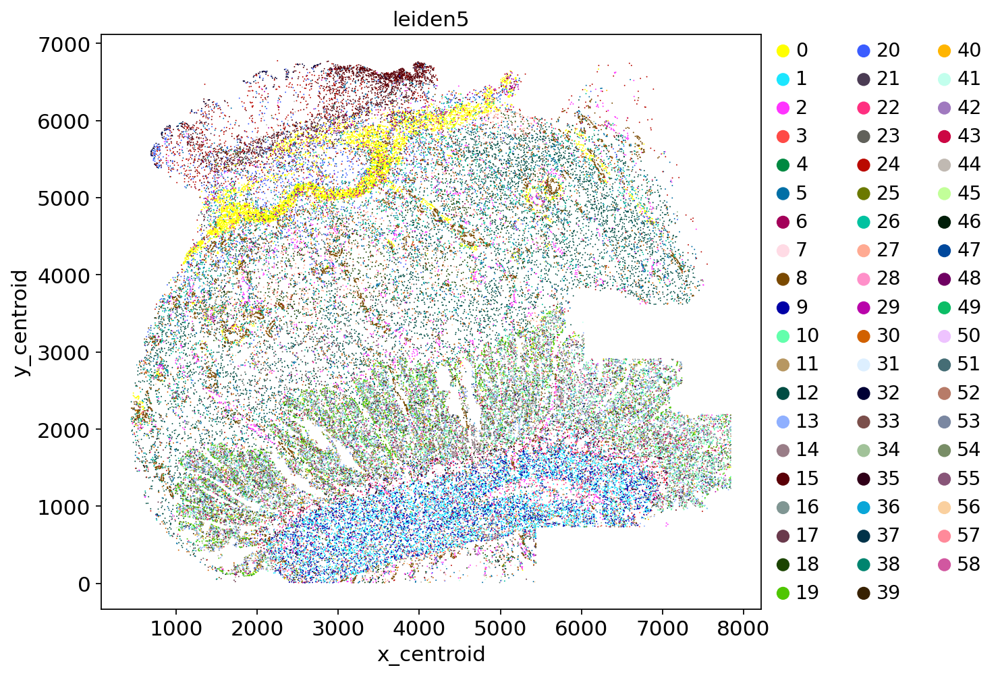

In [948]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
             x='x_centroid', y='y_centroid', color="leiden5", size=3)

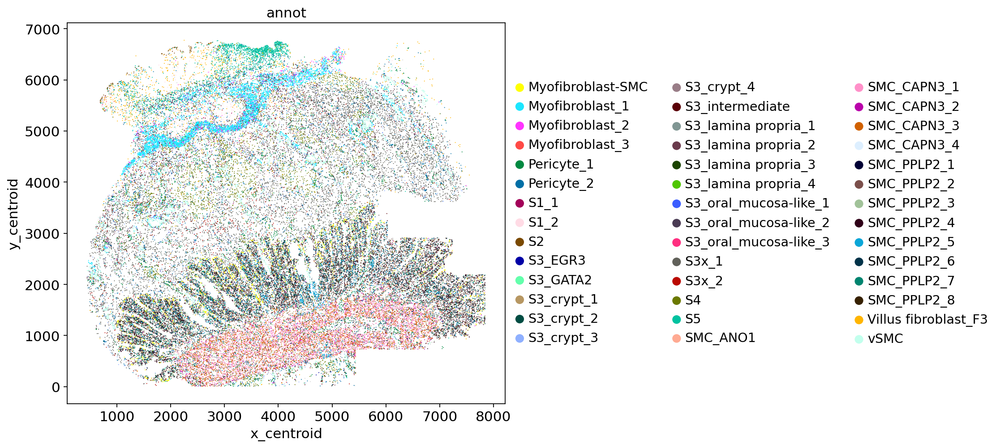

In [949]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
             x='x_centroid', y='y_centroid', color="annot", size=3 )

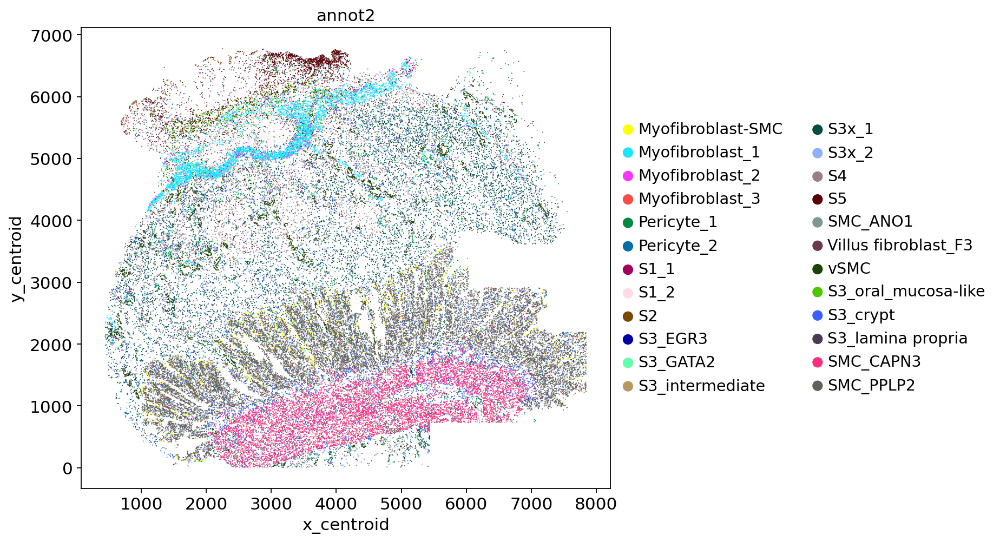

In [950]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
             x='x_centroid', y='y_centroid', color="annot2", size=3)

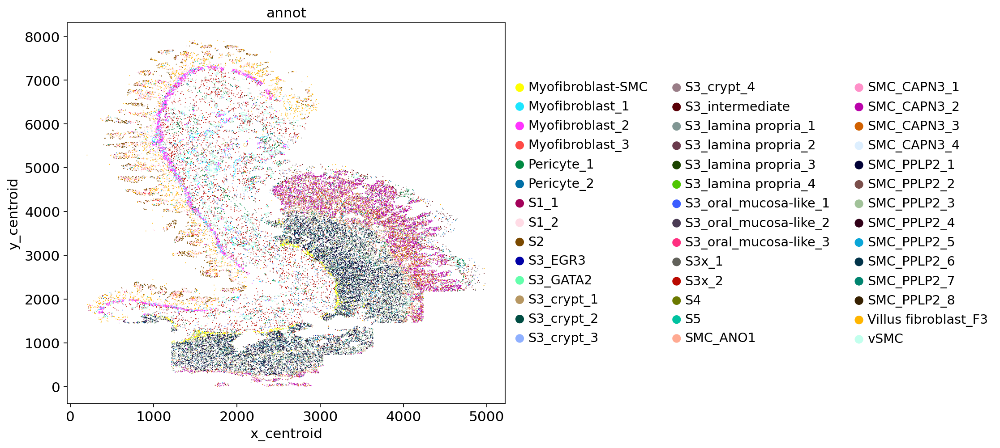

In [951]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_adjacent'],
             x='x_centroid', y='y_centroid', color="annot", size=3)

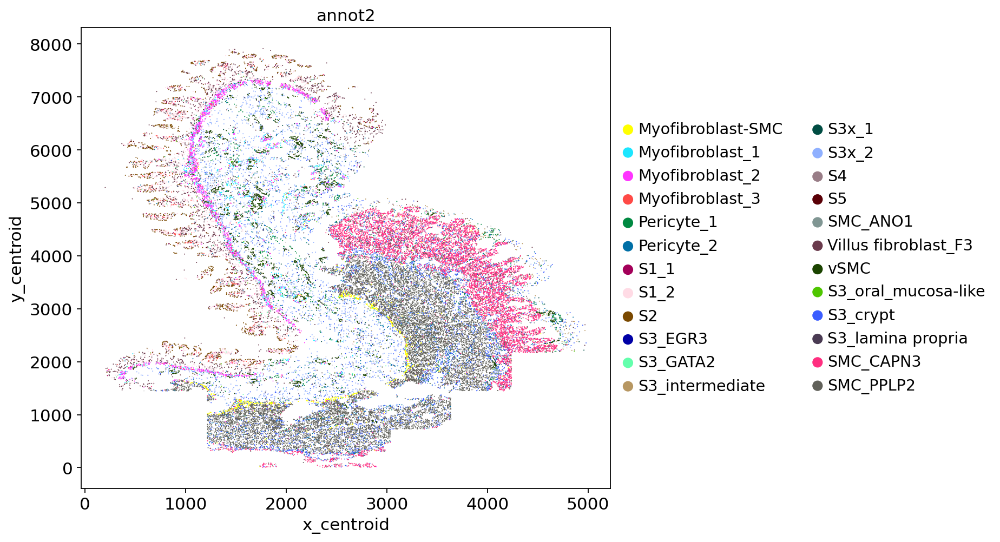

In [952]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_adjacent'],
             x='x_centroid', y='y_centroid', color="annot2", size=3 )

In [953]:
adata_mesen.obs['sample'].value_counts()

sample
0033516_affected    68536
0043587_affected    56164
0033516_adjacent    41716
0043587_adjacent    15181
Name: count, dtype: int64

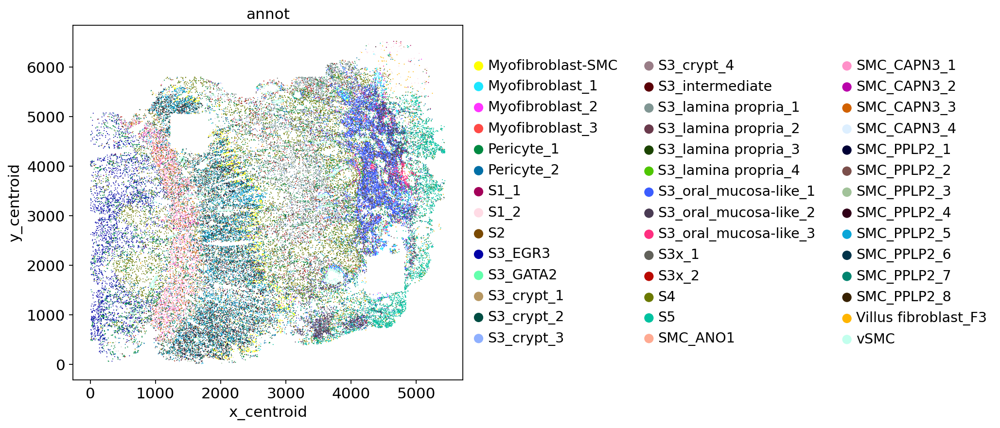

In [941]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0043587_affected'],
             x='x_centroid', y='y_centroid', color="annot", size=3 )

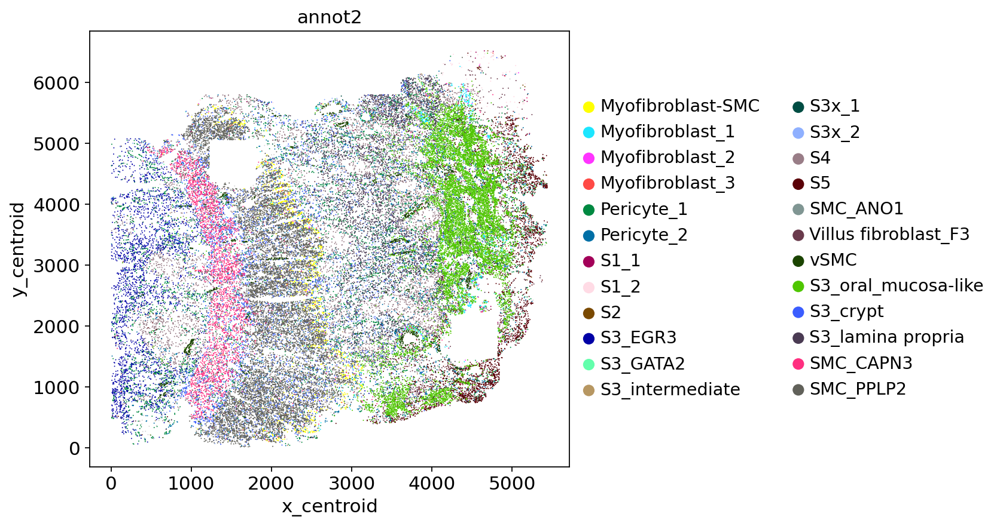

In [942]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0043587_affected'],
             x='x_centroid', y='y_centroid', color="annot2", size=3)

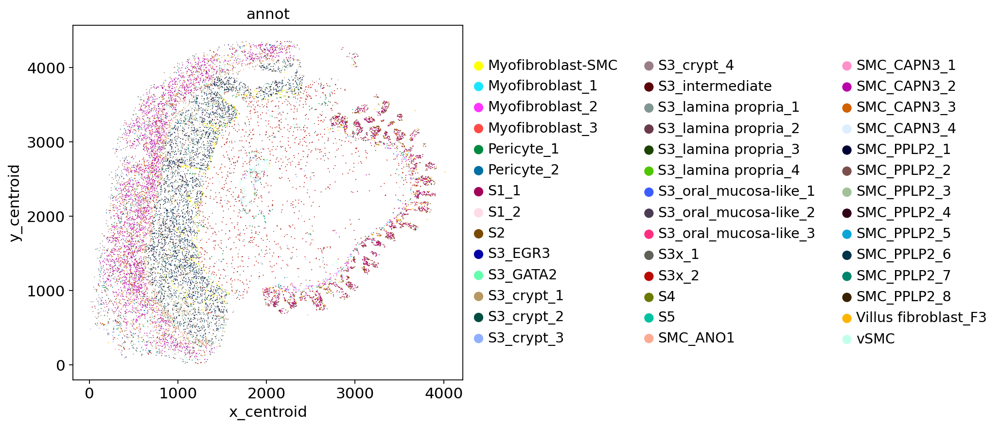

In [943]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0043587_adjacent'],
             x='x_centroid', y='y_centroid', color="annot", size=3)

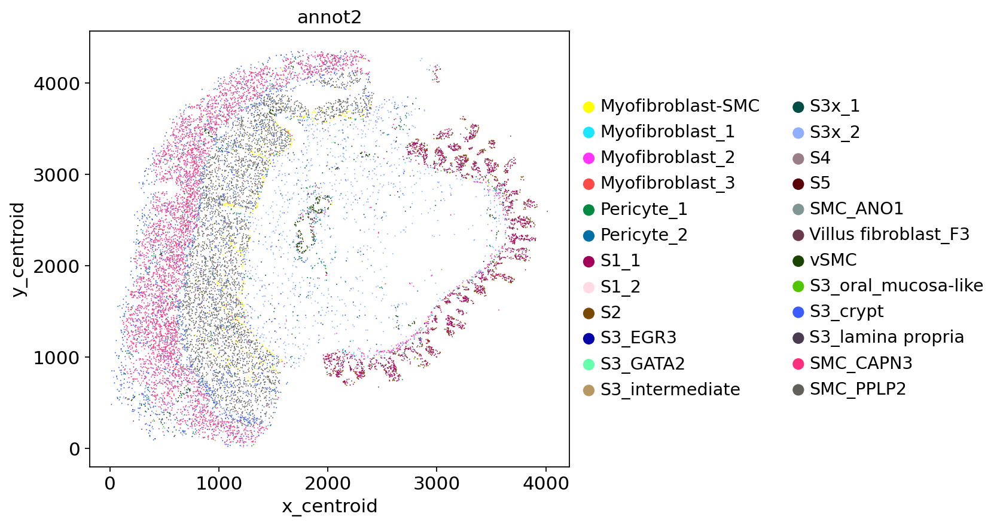

In [944]:
sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0043587_adjacent'],
             x='x_centroid', y='y_centroid', color="annot2", size=3 )

In [277]:
# sc.pl.scatter(adata[adata.obs['sample'] == '0033516_adjacent'],
#              x='x_centroid', y='y_centroid', color="megagut_lvl3_majority_voting", size=10 )

In [49]:
# sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
#              x='x_centroid', y='y_centroid', color="subtype_annot")

In [50]:
# sc.pl.scatter(adata_mesen[adata_mesen.obs['sample'] == '0033516_affected'],
#              x='x_centroid', y='y_centroid', color="S4_prob")

## Call fibroblast subtypes (exploratory)

In [964]:
# adata_mesen

In [965]:
# Maximum 
subtype_mat = adata_mesen.obs[[x + "_prob" for x in subtypes]]
subtype_mat

In [966]:
# Get maximum assignment and probabilities
subtype_assign = subtype_mat.idxmax(axis=1)
subtype_prob_max = subtype_mat.max(axis=1)

In [967]:
subtype_assign = subtype_assign.str.strip("_prob")

In [968]:
subtype_assign.value_counts()

In [969]:
# Require minimum probability
subtype_assign[subtype_prob_max < 0.5] = pd.NA

#subtype_assign[subtype_prob_max < 0.8] = "unknown"

In [970]:
subtype_assign.value_counts()

In [106]:
#subtype_assign[subtype_mat.S4_prob > 0.3] = "S4"

In [107]:
#subtype_assign.value_counts()

In [108]:
adata_mesen.obs['subtype_annot'] = subtype_assign

In [109]:
#adata_mesen.obs['subtype_annot']

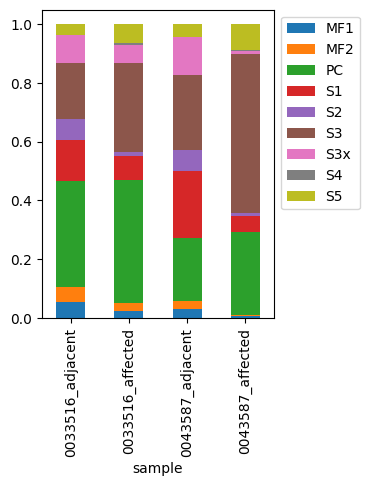

In [110]:
rcParams["figure.figsize"] = (3, 4)


# Get dictionary of colors
#color_dict = dict(zip(adata_mesen.obs.subtype_annot.cat.categories, adata_mesen.uns['subtype_annot_colors']))

counts = pd.crosstab(adata_mesen.obs.subtype_annot, adata_mesen.obs['sample'], normalize='columns')
ax = counts.T.plot(kind='bar', stacked=True,
                   #color=counts.index.map(color_dict)
)
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.grid(False)

plt.savefig("figures/barplot_xenium5k_celltypist_mesenchymal_subtype.pdf", bbox_inches ="tight")
plt.show()